In [8]:
import os

from tqdm import tqdm

import itertools
import warnings
warnings.filterwarnings('ignore')

from matplotlib import gridspec
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
from matplotlib import cm
import matplotlib.ticker as mtick
from matplotlib.ticker import MaxNLocator
import matplotlib.patches as patches

import datetime
from scipy import stats
from scipy.stats import pearsonr
import statsmodels.api as sm

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

from statsmodels.tsa.seasonal import STL


In [9]:
data_path = "../Datasets/"

NTL_data = pd.read_csv(data_path+"NTL_Provincial.csv", parse_dates=True, index_col = 0)*10#.reset_index(drop=True)*10
NTL_data.astype(float)

def outlier_removal(dataframe):
    q_low = dataframe.quantile(0.05)
    q_hi  = dataframe.quantile(0.95)
    dataframe = dataframe[(dataframe < q_hi) & (dataframe > q_low)]
    return dataframe

NTL_data = outlier_removal(NTL_data)
NTL_data = NTL_data.interpolate(method='linear', limit_direction='both')
NTL_data
# NTL_data['Leyte']

,Iloilo,Antique,Capiz,Aklan,Guimaras,Negros Occidental,Negros Oriental,Samar,Eastern Samar,Northern Samar,Leyte,Southern Leyte,Cebu,Bohol
date,,,,,,,,,,,,,,
2012-01-19,73487.074510,25216.913725,19308.235294,14627.584314,4799.678431,99064.192157,42485.839216,21656.313725,24806.525490,14512.356863,57063.121569,8679.635294,248979.886274,32773.301961
2012-01-20,73487.074510,25216.913725,19308.235294,14627.584314,4799.678431,99064.192157,42485.839216,38766.662745,24806.525490,14512.356863,57063.121569,8679.635294,248979.886274,32773.301961
2012-01-21,73487.074510,16195.047059,19308.235294,14627.584314,4799.678431,99064.192157,45108.560784,14359.725490,24806.525490,20957.549020,80784.411765,10146.709804,248979.886274,38964.603922
2012-01-22,77170.901961,17509.341176,19308.235294,14627.584314,3042.862745,107024.138824,43553.050980,16640.929412,27364.367059,21218.061176,52100.894118,10954.414902,195750.937255,38078.130532
2012-01-23,80854.729412,18823.635294,19308.235294,14627.584314,3086.324183,114984.085490,43672.253595,42713.345098,29922.208627,21478.573333,50388.549020,11762.120000,196613.020588,37191.657143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-12-22,131963.556863,27357.905882,34897.090196,28020.105882,7421.517647,178244.984314,64202.290196,25808.427451,26209.196078,24532.376471,95696.207843,13240.478431,369247.866667,57393.431373
2024-12-23,132050.666667,27356.741176,34889.584314,28034.862745,7450.301961,178359.635294,64393.584314,55835.831373,26200.066667,24528.968627,95828.019608,13244.513725,369504.764706,57956.756863
2024-12-24,131947.129412,27345.639216,34884.439216,28050.560784,7427.313725,178251.917647,64367.639216,28886.654902,26202.047059,24535.756863,95620.376471,13249.105882,369313.886274,57970.062745


In [10]:
filtered_ma_df = pd.DataFrame(index=NTL_data.index)

# Drop rows where all values are NaN — avoids plotting invalid X
filtered_ma_df = filtered_ma_df.dropna(how='all')

# Ensure the index is datetime
filtered_ma_df.index = pd.to_datetime(filtered_ma_df.index, errors='coerce')

# Drop rows where index is NaT (in case parsing failed)
filtered_ma_df = filtered_ma_df[~filtered_ma_df.index.isna()]

fig = go.Figure()

for col in NTL_data.columns:
    # Filter 5–95th percentile
    q_low = NTL_data[col].quantile(0.05)
    q_high = NTL_data[col].quantile(0.95)
    filtered = NTL_data[col].clip(lower=q_low, upper=q_high)

    
    filled = filtered.ffill()
    ma = filled.rolling(window=7, min_periods=1).mean()
    # # Raw data (light gray)
    # fig.add_trace(go.Scatter(
    #     x=ntl_df.index, y=ntl_df[col],
    #     mode='lines', name=f"{col} Raw",
    #     line=dict(color='lightgray', width=1),
    #     showlegend=False, opacity=0.4
    # ))

    # 7-day Moving Average
    # ma = filtered.rolling(window=7, min_periods=1).mean()
    
    filtered_ma_df[col] = ma

    fig.add_trace(go.Scatter(
        x=NTL_data.index, y=ma,
        mode='lines', name=f"{col} 7d MA",
        line=dict(width=2)
    ))

# Layout
fig.update_layout(
    xaxis=dict(
        range=[filtered_ma_df.index.min(), filtered_ma_df.index.max()],
        rangeselector=dict(
            buttons=[
                dict(count=30, label='1m', step='day', stepmode='backward'),
                dict(count=90, label='3m', step='day', stepmode='backward'),
                dict(step='all')
            ]
        ),
        rangeslider=dict(visible=True),
        type='date'
    ),
    paper_bgcolor='rgba(0,0,0,0)', # transparent background 
    plot_bgcolor='rgba(0,0,0,0)', # transparent plot area,
    width=1200, 
    height=600
)

# fig.write_image("../Images/Provincial NTL.png", scale=2)
# fig.write_html("../HTML Files/Provincial NTL.html")
fig.show()

In [11]:
# Ensure datetime index on source data
NTL_data.index = pd.to_datetime(NTL_data.index, errors='coerce')
NTL_data = NTL_data[~NTL_data.index.isna()]  # Drop rows with invalid date

# Group definitions
island_groups = {
    "Panay": ["Iloilo", "Antique", "Capiz", "Aklan", "Guimaras"],
    "Negros": ["Negros Occidental", "Negros Oriental"],
    "Samar_Leyte": ["Samar", "Eastern Samar", "Northern Samar", "Leyte", "Southern Leyte"],
    "Cebu": ["Cebu"],
    "Bohol": ["Bohol"]
}

# Prepare output container
grouped_ntl_df = pd.DataFrame(index=NTL_data.index)

# Group by island region, sum available provinces
for group, provinces in island_groups.items():
    available = [p for p in provinces if p in NTL_data.columns]
    if available:  # Only proceed if at least one province is found
        grouped_ntl_df[group] = NTL_data[available].sum(axis=1)

# Final cleanup
grouped_ntl_df = grouped_ntl_df.dropna(how='all')  # Drop rows with all NaN
grouped_ntl_df.index = pd.to_datetime(grouped_ntl_df.index, errors='coerce')
grouped_ntl_df = grouped_ntl_df[~grouped_ntl_df.index.isna()]

In [12]:
xl = pd.ExcelFile("../Datasets/NGCP_hourly_load.xlsx")
sheets = {name: xl.parse(name) for name in xl.sheet_names}

In [13]:
# Ensure NTL index is datetime and clean
grouped_ntl_df.index = pd.to_datetime(grouped_ntl_df.index, errors='coerce')
grouped_ntl_df = grouped_ntl_df[~grouped_ntl_df.index.isna()]

In [14]:
# Island group sheet mapping — must match keys in grouped_ntl_df
sheet_map = {
    "Panay": "PANAY HOURLY LOAD 2013-2024",
    "Negros": "NEGROS HOURLY LOAD 2013-2024",
    "Samar_Leyte": "LEY-SAM HOURLY LOAD 2013-2024",
    "Cebu": "CEBU HOURLY LOAD 2013-2024",
    "Bohol": "BOHOL LOAD 2013-2024"
}

In [15]:
# Final container
combined = pd.DataFrame(index=grouped_ntl_df.index)

for group, sheet_name in sheet_map.items():
    if group not in grouped_ntl_df.columns:
        continue

    # Step 1: Load raw preview to detect header
    preview = xl.parse(sheet_name, header=None).head(5)
    print(f"Preview of '{sheet_name}':")
    print(preview)

    # Step 2: Load with correct header (assumed at row 1 for NGCP format)
    df = xl.parse(sheet_name, header=1)

    # Step 3: Rename first column if unnamed
    if df.columns[0] != 'DATE':
        df.rename(columns={df.columns[0]: 'DATE'}, inplace=True)

    # Step 4: Convert and clean datetime
    df['DATE'] = pd.to_datetime(df['DATE'], errors='coerce')
    df = df[~df['DATE'].isna()]
    df = df.set_index('DATE')

    # Ensure all column names are strings (safe coercion)
    df.columns = [str(col).strip() for col in df.columns]

    # Extract column for "1" or "Hour 1"
    hour_col = None
    for col in df.columns:
        if col.strip() == "1" or col.strip().lower() in ["hour 1", "1am"]:
            hour_col = col
            break

    # Fallback: try column index 1 (usually after DATE)
    if not hour_col and len(df.columns) > 1:
        hour_col = df.columns[1]

    # Raise error if still not found
    if hour_col not in df.columns:
        raise KeyError(f"Hour 1 column not found in {sheet_name}")

    # Extract the column
    grid_1am = df[hour_col].copy()
    grid_1am = grid_1am.reindex(grouped_ntl_df.index)

    # Step 6: Add NTL and Grid under multi-index
    combined[(group, 'NTL')] = grouped_ntl_df[group]
    combined[(group, 'Grid')] = grid_1am

Preview of 'PANAY HOURLY LOAD 2013-2024':
                    0         1      2      3      4      5      6      7   \
0      COINCIDENT PEAK  Hour No.    NaN    NaN    NaN    NaN    NaN    NaN   
1                 DATE         1    2.0    3.0    4.0    5.0    6.0    7.0   
2  2013-01-01 00:00:00       194  160.0  145.0  138.0  136.0  132.0  128.0   
3  2013-01-02 00:00:00       135  132.0  128.0  125.0  128.0  132.0  128.0   
4  2013-01-03 00:00:00       143  138.0  135.0  133.0  139.0  148.0  145.0   

      8      9   ...     17     18     19     20     21     22     23     24  \
0    NaN    NaN  ...    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    8.0    9.0  ...   17.0   18.0   19.0   20.0   21.0   22.0   23.0   24.0   
2  129.0  134.0  ...  154.0  214.0  227.0  215.0  197.0  171.0  153.0  141.0   
3  148.0  180.0  ...  198.0  242.0  244.0  232.0  211.0  186.0  164.0  150.0   
4  159.0  188.0  ...  203.0  242.0  245.0  228.0  209.0  185.0  161.0  148.0   

   25   

In [16]:
# Create MultiIndex columns and sort
combined.columns = pd.MultiIndex.from_tuples(combined.columns)
combined = combined.sort_index(axis=1)

# Preview
combined.head()

Bohol               Cebu                Negros                 \
            Grid           NTL Grid            NTL   Grid            NTL   
date                                                                       
2012-01-19   NaN  32773.301961  NaN  248979.886274    NaN  141550.031373   
2012-01-20   NaN  32773.301961  NaN  248979.886274    NaN  141550.031373   
2012-01-21   NaN  38964.603922  NaN  248979.886274    NaN  144172.752941   
2012-01-22   NaN  38078.130532  NaN  195750.937255    NaN  150577.189804   
2012-01-23   NaN  37191.657143  NaN  196613.020588    NaN  158656.339085   

           Panay                Samar_Leyte                 
            Grid            NTL        Grid            NTL  
date                                                        
2012-01-19   NaN  137439.486275         NaN  126717.952941  
2012-01-20   NaN  137439.486275         NaN  143828.301961  
2012-01-21   NaN  128417.619608         NaN  151054.921569  
2012-01-22   NaN  131658.925490         NaN  128278.666667  
2012-01-23   NaN  136700.508497         NaN  156264.796078

In [17]:
import plotly.graph_objects as go

# Choose rolling window
rolling_window = 30

# Create base figure
fig = go.Figure()

# Keep track of traces and visibility toggles
buttons = []
group_list = combined.columns.get_level_values(0).unique()

# List of major storms affecting Visayas grid (Yolanda, Ursula, Odette, Agaton)
storm_events = [
    {"name": "Yolanda", "date": "2013-11-08"},
    {"name": "Ursula",  "date": "2019-12-24"},
    {"name": "Odette",  "date": "2021-12-16"},
    {"name": "Agaton",  "date": "2022-04-10"},
]

# For each island group
for i, group in enumerate(group_list):
    # Extract NTL and Grid data
    ntl = combined[(group, 'NTL')]
    grid = combined[(group, 'Grid')]

    # Align dates and trim to common range
    aligned = pd.concat([ntl, grid], axis=1).dropna()
    aligned.columns = ['ntl', 'grid']

    # Apply rolling smoothing
    ntl_raw = aligned['ntl']
    ntl_smoothed = ntl_raw.rolling(window=rolling_window, min_periods=1).mean()
    grid_norm = 100 * (aligned['grid'] - aligned['grid'].min()) / (aligned['grid'].max() - aligned['grid'].min())
    grid_smoothed = grid_norm.rolling(window=rolling_window, min_periods=1).mean()

    # Create traces (3 per group)
    fig.add_trace(go.Scatter(
        x=aligned.index, y=ntl_raw,
        name=f'{group} Raw NTL',
        line=dict(color='gray'),
        opacity=0.1,
        visible=(i == 0),
        yaxis='y1'
    ))

    fig.add_trace(go.Scatter(
        x=aligned.index, y=ntl_smoothed,
        name=f'{group} Smoothed NTL',
        line=dict(color='red'),
        visible=(i == 0),
        yaxis='y1'
    ))

    fig.add_trace(go.Scatter(
        x=aligned.index, y=grid_smoothed,
        name=f'{group} Grid Output',
        line=dict(color='black'),
        visible=(i == 0),
        yaxis='y2'
    ))

    # Visibility logic: 3 traces per group
    visibility = [False] * len(group_list) * 3
    visibility[i * 3] = visibility[i * 3 + 1] = visibility[i * 3 + 2] = True

    # Dropdown button
    buttons.append(dict(
        label=group,
        method='update',
        args=[{'visible': visibility}]))
    
for event in storm_events:
    event_date = pd.to_datetime(event["date"])
    fig.add_vline(
        x=event_date,
        line_width=1.5,
        line_dash="dash",
        line_color="blue",
    )
    fig.add_annotation(
        x=event_date,
        y=1,
        yref='paper',
        text=event["name"],
        showarrow=False,
        font=dict(color="blue"),
        bgcolor="white",
        bordercolor="blue",
        borderwidth=1,
        borderpad=2,
        xanchor="left"
    )

# Layout with dropdown
fig.update_layout(
    updatemenus=[dict(
        type='buttons',
        direction='right',
        buttons=buttons,
        pad={'r': 10, 't': 10},
        showactive=True,
        x=0.2,
        xanchor='center',
        y=1.15,
        yanchor='top'
    )],
    title='NTL and Power Restoration by Island Group',
    template='plotly_white',
    xaxis=dict(
        title='Date',
        rangeslider=dict(visible=True),
        type='date'
    ),
    yaxis=dict(
        title=dict(text='Estimated NTL Radiance (%)', font=dict(color='red')),
        tickfont=dict(color='red')
    ),
    yaxis2=dict(
        title=dict(text='Grid Output (Normalized %)', font=dict(color='black')),
        tickfont=dict(color='black'),
        overlaying='y',
        side='right'
    ),
    legend=dict(x=0.5, y=1, orientation='h'),
    height=600,
    width=1200
)

# fig.write_image("../Images/NGCP vs NTL.png", scale=2)
fig.write_html("../HTML Files/NGCP vs NTL.html")
fig.show()

In [29]:
import plotly.graph_objects as go
import pandas as pd

# Rolling average options and island groups
rolling_options = [1, 4, 7, 14, 21, 30, 45, 60, 90]
group_list = combined.columns.get_level_values(0).unique()


# Storm events
storm_events = [
    {"name": "Yolanda", "date": "2013-11-08"},
    {"name": "Ursula",  "date": "2019-12-24"},
    {"name": "Odette",  "date": "2021-12-16"},
    {"name": "Agaton",  "date": "2022-04-10"},
]

# Initialize figure and trace container
fig = go.Figure()
trace_refs = []  # (group, window, trace_index) for toggling logic

# Build traces: 1 raw + 2 smoothed per window × group
for g_idx, group in enumerate(group_list):
    ntl = combined[(group, 'NTL')]
    grid = combined[(group, 'Grid')]
    aligned = pd.concat([ntl, grid], axis=1).dropna()
    aligned.columns = ['ntl', 'grid']

    # Raw NTL — only once per group
    fig.add_trace(go.Scatter(
        x=aligned.index, y=aligned['ntl'],
        name=f'{group} Raw NTL',
        line=dict(color='gray'), opacity=0.1,
        visible=(g_idx == 0),
        yaxis='y1'
    ))
    trace_refs.append((group, 'raw', len(fig.data) - 1))

    # Add smoothed NTL and Grid per rolling window
    for w_idx, window in enumerate(rolling_options):
        ntl_smoothed = aligned['ntl'].rolling(window=window, min_periods=1).mean()
        grid_norm = 100 * (aligned['grid'] - aligned['grid'].min()) / (aligned['grid'].max() - aligned['grid'].min())
        grid_smoothed = grid_norm.rolling(window=window, min_periods=1).mean()

        # NTL Smoothed
        fig.add_trace(go.Scatter(
            x=aligned.index, y=ntl_smoothed,
            name=f'{group} NTL ({window}d)',
            line=dict(color='red'),
            visible=(g_idx == 0 and w_idx == 0),
            yaxis='y1'
        ))
        trace_refs.append((group, f'ntl_{window}', len(fig.data) - 1))

        # Grid Smoothed
        fig.add_trace(go.Scatter(
            x=aligned.index, y=grid_smoothed,
            name=f'{group} Grid ({window}d)',
            line=dict(color='black'),
            visible=(g_idx == 0 and w_idx == 0),
            yaxis='y2'
        ))
        trace_refs.append((group, f'grid_{window}', len(fig.data) - 1))

# Add storm markers
for event in storm_events:
    event_date = pd.to_datetime(event["date"])
    fig.add_vline(x=event_date, line_dash="dash", line_color="blue")
    fig.add_annotation(
        x=event_date,
        y=1,
        yref='paper',
        text=event["name"],
        showarrow=False,
        font=dict(color="blue"),
        bgcolor="white",
        bordercolor="blue",
        borderwidth=1,
        borderpad=2,
        xanchor="left"
    )

# --- Buttons: Island group selector ---
buttons = []
for group in group_list:
    visibility = [False] * len(fig.data)
    for (g, trace_type, idx) in trace_refs:
        if g == group:
            if trace_type == 'raw':
                visibility[idx] = True
            elif trace_type == f'ntl_{rolling_options[0]}' or trace_type == f'grid_{rolling_options[0]}':
                visibility[idx] = True
    buttons.append(dict(
        label=group,
        method='update',
        args=[{'visible': visibility},
              {'title': f"NTL and Grid Output"}]
    ))

# --- Slider: Rolling average control ---
slider_steps = []
for i, window in enumerate(rolling_options):
    visibility = [False] * len(fig.data)
    for (g, trace_type, idx) in trace_refs:
        if trace_type == 'raw' and g == group_list[0]:
            visibility[idx] = True
        if trace_type == f'ntl_{window}' and g == group_list[0]:
            visibility[idx] = True
        if trace_type == f'grid_{window}' and g == group_list[0]:
            visibility[idx] = True
    slider_steps.append(dict(
        method="update",
        label=f"{window}d",
        args=[{"visible": visibility},
              {"title": f"NTL and Grid Output ({window}-day Rolling Avg)"}]
    ))

# --- Final layout ---
fig.update_layout(
    updatemenus=[dict(
        type='buttons',
        direction='right',
        buttons=buttons,
        pad={'r': 10, 't': 10},
        showactive=True,
        x=0.2,
        xanchor='center',
        y=1.15,
        yanchor='top'
    )],
    sliders=[dict(
        active=0,
        currentvalue={"prefix": "Rolling Avg: "},
        pad={"t": 100},
        steps=slider_steps
    )],
    title=f"NTL and Grid Output - {group_list[0]}",
    template='plotly_white',
    xaxis=dict(
        title='Date',
        rangeslider=dict(visible=True),
        type='date'
    ),
    yaxis=dict(
        title='Estimated NTL Radiance (%)',
        tickfont=dict(color='red')
    ),
    yaxis2=dict(
        title='Grid Output (Normalized %)',
        tickfont=dict(color='black'),
        overlaying='y',
        side='right'
    ),
    legend=dict(x=0.5, y=1, orientation='h'),
    height=600,
    width=1200
)

fig.write_html("../HTML Files/NGCP_NTL_Interactive.html",include_plotlyjs='cdn')
fig.show()

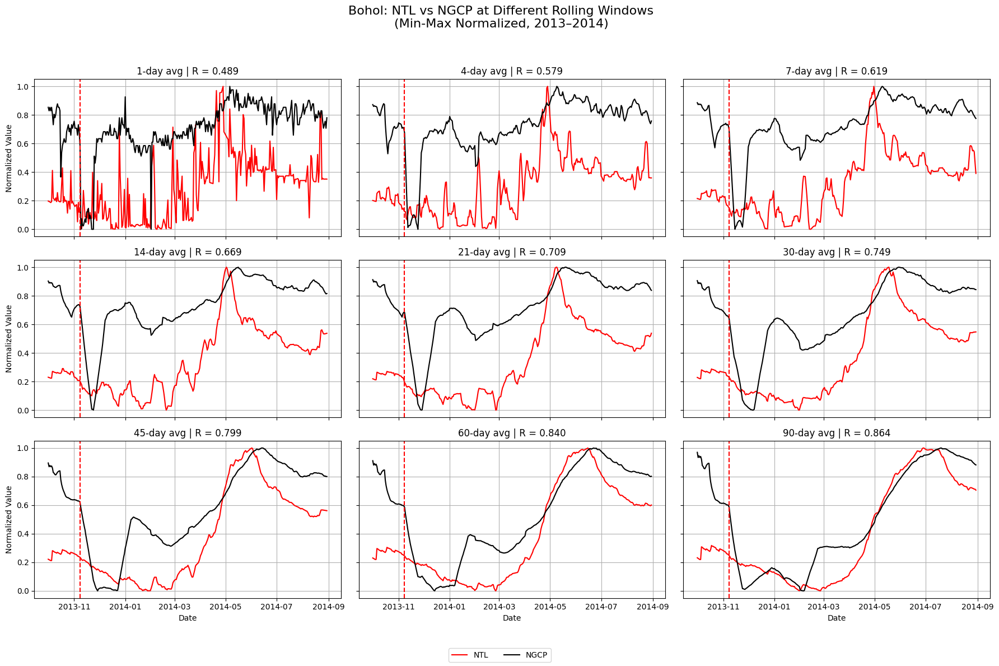

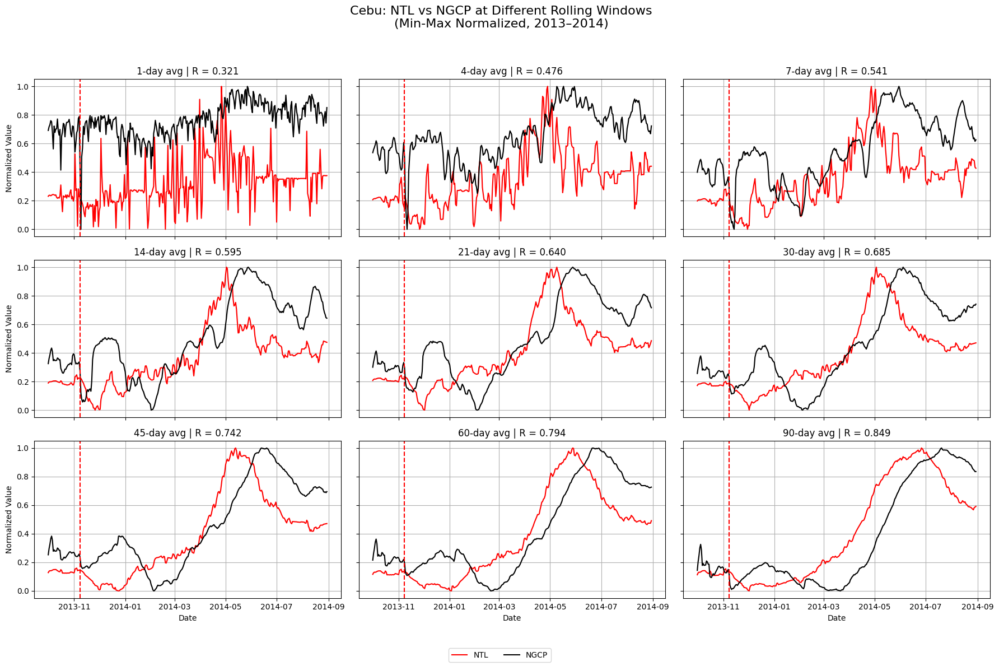

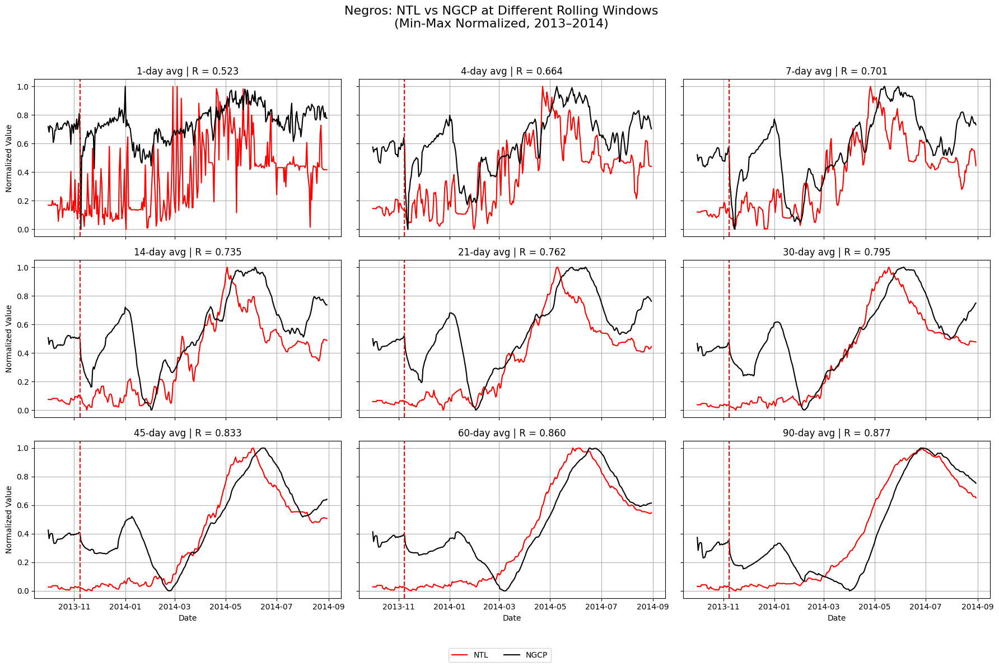

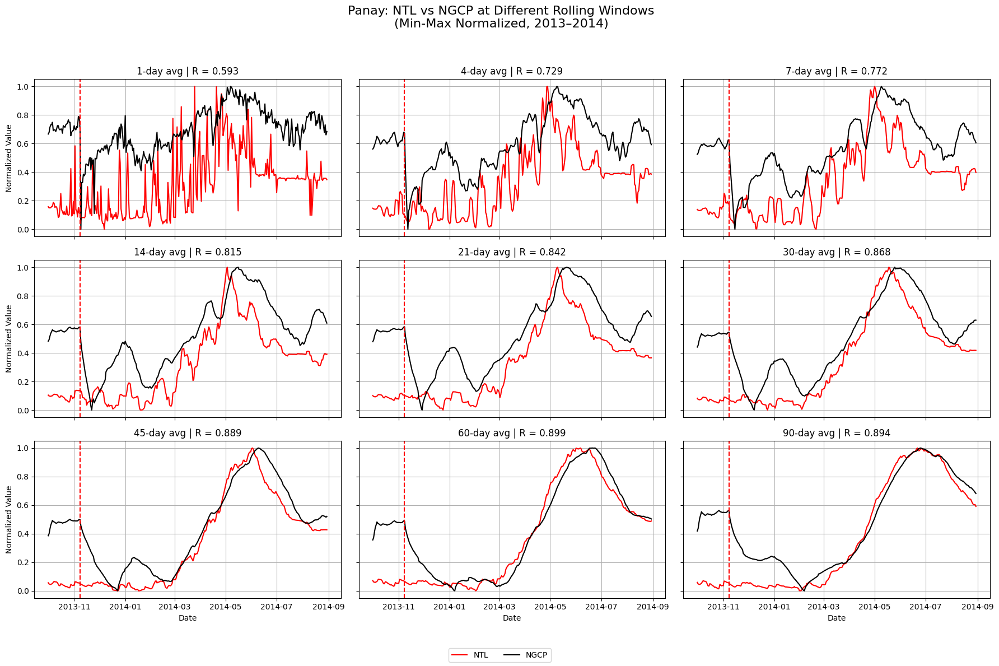

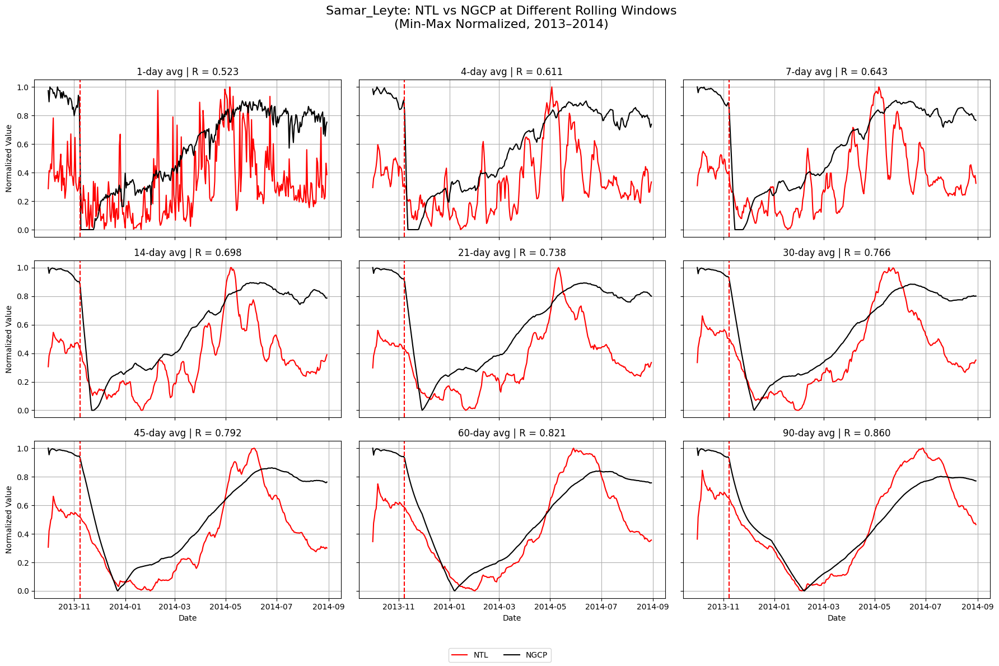

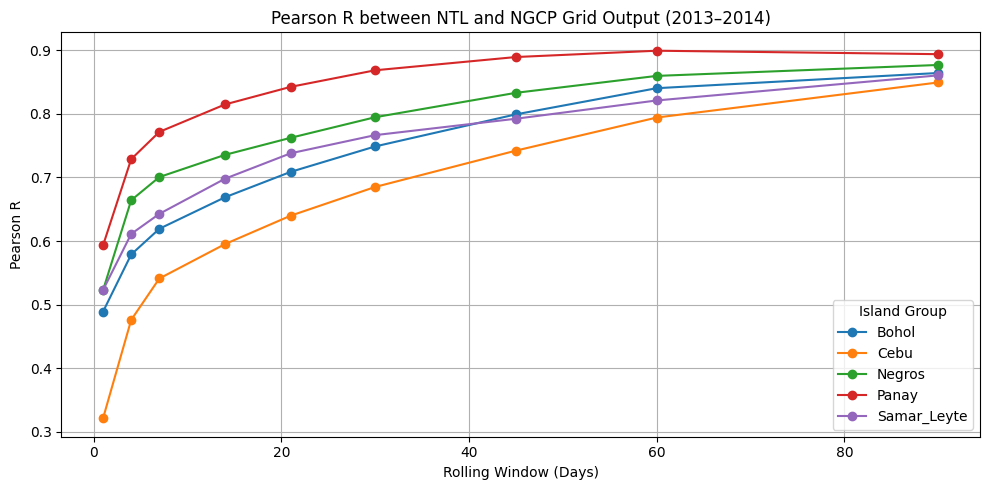

In [30]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

# --- Set analysis window ---
start_date = '2013-10-01'
end_date = '2014-08-30'
landfall_date = '2013-11-08'
rolling_options = [1, 4, 7, 14, 21, 30, 45, 60, 90]

# --- Extract group names from combined DataFrame ---
group_list = combined.columns.get_level_values(0).unique()

# --- Container to aggregate R values ---
summary_rows = []

# --- Loop through each group and generate subplots ---
for group in group_list:
    ntl_series = combined[(group, 'NTL')][start_date:end_date]
    ngcp_series = combined[(group, 'Grid')][start_date:end_date]

    r_values = {}

    fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 12), sharex=True, sharey=True)
    axes = axes.flatten()

    for i, window in enumerate(rolling_options):
        ax = axes[i]

        # Rolling smoothing
        ntl_roll = ntl_series.rolling(window=window, min_periods=1).mean()
        ngcp_roll = ngcp_series.rolling(window=window, min_periods=1).mean()

        # Min-max normalization
        ntl_norm = (ntl_roll - ntl_roll.min()) / (ntl_roll.max() - ntl_roll.min())
        ngcp_norm = (ngcp_roll - ngcp_roll.min()) / (ngcp_roll.max() - ngcp_roll.min())

        # Compute Pearson R
        df = pd.concat([ntl_norm, ngcp_norm], axis=1).dropna()
        df.columns = ['ntl', 'ngcp']
        if len(df) > 2:
            r, _ = pearsonr(df['ntl'], df['ngcp'])
        else:
            r = np.nan

        r_values[window] = r
        summary_rows.append({'group': group, 'window': window, 'r': r})

        # Plot subplot
        ax.plot(df.index, df['ntl'], label='NTL', color='red')
        ax.plot(df.index, df['ngcp'], label='NGCP', color='black')
        ax.axvline(pd.to_datetime(landfall_date), color='red', linestyle='--')
        ax.set_title(f'{window}-day avg | R = {r:.3f}' if not np.isnan(r) else f'{window}-day avg | R = N/A')
        ax.grid(True)
        if i >= 6:
            ax.set_xlabel('Date')
        if i % 3 == 0:
            ax.set_ylabel('Normalized Value')

    # Format full figure
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=2)
    fig.suptitle(f'{group}: NTL vs NGCP at Different Rolling Windows\n(Min-Max Normalized, 2013–2014)', fontsize=16)
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    plt.savefig(f"../Images/{group}_NTL_NGCP_PearsonR_Subplots.png", dpi=300)
    plt.show()

# --- Part 2: Summary line plot with all groups ---
r_df = pd.DataFrame(summary_rows)

plt.figure(figsize=(10, 5))
for group in r_df['group'].unique():
    subset = r_df[r_df['group'] == group]
    plt.plot(subset['window'], subset['r'], marker='o', label=group)

plt.title("Pearson R between NTL and NGCP Grid Output (2013–2014)")
plt.xlabel("Rolling Window (Days)")
plt.ylabel("Pearson R")
plt.grid(True)
plt.legend(title="Island Group")
plt.tight_layout()
plt.savefig("../Images/NTL_NGCP_PearsonR_Summary_AllGroups.png", dpi=300)
plt.show()